# TanukiGAN
## Abstract
- Total FID score : 
- Used 4 GPUs in parallel. If you want a gpu, change "ngpu" to 1
- Input imgs([img_align_celeba folder](https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg)) must be in ./data/celeba . You can adjust by changing the dataroot variable.
- Output imgs would be saved in ./img/fake and ./img/real

## Applied techniques

- [Building baseline DCGAN](https://pytorch.org/tutorials/beginner/dcgan_faces_tutorial.html)
- [Proper Batch size is 8 or 16](https://medium.com/intel-student-ambassadors/tips-on-training-your-gans-faster-and-achieve-better-results-9200354acaa5)
- Decaying learning rate
- More compact latent vectors and kernels <- Because, CelebA dataset has smaller size than one used in [the original paper](https://arxiv.org/abs/1511.06434)
- Data augumentation (Randomly flip in horizontal axis)
- Wasserstein Loss (Recommended from this, and I implemented with referencing to [this](https://machinelearningmastery.com/how-to-implement-wasserstein-loss-for-generative-adversarial-networks/) and [also this](https://github.com/eriklindernoren/PyTorch-GAN/blob/master/implementations/wgan/wgan.py)
- Sampling z vectors in Normal dist and Input regulization from [here](https://github.com/jaingaurav3/GAN-Hacks)
- Dropout layers(p=0.5) for giving noise robustness to D and G.
- One-sided abel smoothing motivated from [here](https://towardsdatascience.com/gan-ways-to-improve-gan-performance-acf37f9f59b)

In [1]:
%matplotlib inline

In [2]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


Inputs
------

Let’s define some inputs for the run:

-  **dataroot** - the path to the root of the dataset folder. We will
   talk more about the dataset in the next section
-  **workers** - the number of worker threads for loading the data with
   the DataLoader
-  **batch_size** - the batch size used in training. The DCGAN paper
   uses a batch size of 128
-  **image_size** - the spatial size of the images used for training.
   This implementation defaults to 64x64. If another size is desired,
   the structures of D and G must be changed. See
   `here <https://github.com/pytorch/examples/issues/70>`__ for more
   details
-  **nc** - number of color channels in the input images. For color
   images this is 3
-  **nz** - length of latent vector
-  **ngf** - relates to the depth of feature maps carried through the
   generator
-  **ndf** - sets the depth of feature maps propagated through the
   discriminator
-  **num_epochs** - number of training epochs to run. Training for
   longer will probably lead to better results but will also take much
   longer
-  **lr** - learning rate for training. As described in the DCGAN paper,
   this number should be 0.0002
-  **beta1** - beta1 hyperparameter for Adam optimizers. As described in
   paper, this number should be 0.5
-  **ngpu** - number of GPUs available. If this is 0, code will run in
   CPU mode. If this number is greater than 0 it will run on that number
   of GPUs




In [3]:
# Root directory for dataset
dataroot = "data/celeba"

# Number of workers for dataloader
workers = 4

# Batch size during training
batch_size = 16*4

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 128

# Size of feature maps in generator
ngf = 72

# Size of feature maps in discriminator
ndf = 72

# Number of training epochs ~40mins
num_epochs = 10

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 4

# Drop out rate
lr_decay_rate = 0.95

Data
----

In this tutorial we will use the `Celeb-A Faces
dataset <http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html>`__ which can
be downloaded at the linked site, or in `Google
Drive <https://drive.google.com/drive/folders/0B7EVK8r0v71pTUZsaXdaSnZBZzg>`__.
The dataset will download as a file named *img_align_celeba.zip*. Once
downloaded, create a directory named *celeba* and extract the zip file
into that directory. Then, set the *dataroot* input for this notebook to
the *celeba* directory you just created. The resulting directory
structure should be:

::

   /path/to/celeba
       -> img_align_celeba  
           -> 188242.jpg
           -> 173822.jpg
           -> 284702.jpg
           -> 537394.jpg
              ...

This is an important step because we will be using the ImageFolder
dataset class, which requires there to be subdirectories in the
dataset’s root folder. Now, we can create the dataset, create the
dataloader, set the device to run on, and finally visualize some of the
training data.




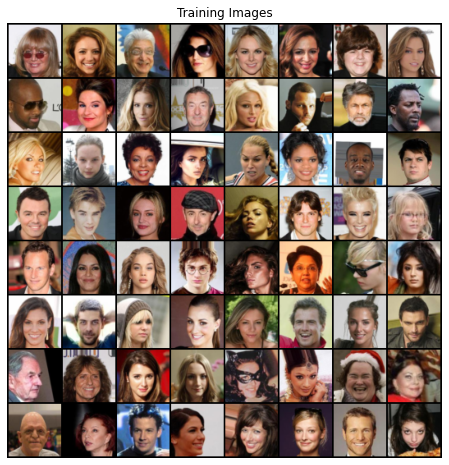

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.RandomHorizontalFlip(),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
dataset

Dataset ImageFolder
    Number of datapoints: 202599
    Root location: data/celeba
    StandardTransform
Transform: Compose(
               Resize(size=64, interpolation=PIL.Image.BILINEAR)
               CenterCrop(size=(64, 64))
               RandomHorizontalFlip(p=0.5)
               ToTensor()
               Normalize(mean=(0.5, 0.5, 0.5), std=(0.5, 0.5, 0.5))
           )

In [6]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

### Create Generator

In [7]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.Dropout(0.5), # Erase the parts ~Follow 1611.07004v1.pdf arxiv
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

Now, we can instantiate the generator and apply the ``weights_init``
function. Check out the printed model to see how the generator object is
structured.




In [8]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
#print(netG)

DataParallel(
  (module): Generator(
    (main): Sequential(
      (0): ConvTranspose2d(128, 576, kernel_size=(4, 4), stride=(1, 1), bias=False)
      (1): BatchNorm2d(576, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): Dropout(p=0.5, inplace=False)
      (3): ReLU(inplace=True)
      (4): ConvTranspose2d(576, 288, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (5): BatchNorm2d(288, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (6): ReLU(inplace=True)
      (7): ConvTranspose2d(288, 144, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (8): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (9): ReLU(inplace=True)
      (10): ConvTranspose2d(144, 72, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (11): BatchNorm2d(72, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (12): ReLU(inplace=True)
      (13): ConvTranspose

### Create Disciminator

In [9]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False), # input channel, output channel, kernel, stride, padding
            nn.Dropout(0.5), # More durable to general inputs? 아직 미반영.
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            #nn.Sigmoid() for w loss
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))
    
# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
#print(netD)

DataParallel(
  (module): Discriminator(
    (main): Sequential(
      (0): Conv2d(3, 72, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (1): Dropout(p=0.5, inplace=False)
      (2): LeakyReLU(negative_slope=0.2, inplace=True)
      (3): Conv2d(72, 144, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (4): BatchNorm2d(144, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (5): LeakyReLU(negative_slope=0.2, inplace=True)
      (6): Conv2d(144, 288, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (7): BatchNorm2d(288, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (8): LeakyReLU(negative_slope=0.2, inplace=True)
      (9): Conv2d(288, 576, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
      (10): BatchNorm2d(576, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (11): LeakyReLU(negative_slope=0.2, inplace=True)
      (12): Conv2d(576, 1, kernel_si

In [11]:
# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

#### Measure consumed time to train

In [12]:
start = torch.cuda.Event(enable_timing=True) 
end = torch.cuda.Event(enable_timing=True) 
start.record()

#### Adaptive learning rate

In [13]:
schedulerD = torch.optim.lr_scheduler.StepLR(optimizer=optimizerD ,step_size=1, gamma=lr_decay_rate)
schedulerG = torch.optim.lr_scheduler.StepLR(optimizer=optimizerG ,step_size=1, gamma=lr_decay_rate)

#### Label smoothing

In [14]:
# One-sided label smoothing
real_label = 0.9
fake_label = 0.0

## Training

In [15]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):
        
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = -torch.mean(output)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = torch.mean(output)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = -torch.mean(output)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()
        
        # Output training stats
        if i == 0:
               print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                         % (epoch, num_epochs, i, len(dataloader),
                            errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))
        
        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())
        
        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))
            
        iters += 1
        
    schedulerD.step()
    schedulerG.step()

Starting Training Loop...
[0/10][0/3166]	Loss_D: -0.1057	Loss_G: 1.7216	D(x): 0.5308	D(G(z)): 0.4251 / -1.7216
[1/10][0/3166]	Loss_D: -5222.2539	Loss_G: 5726.6504	D(x): 3781.9736	D(G(z)): -1440.2805 / -5726.6504
[2/10][0/3166]	Loss_D: -15769.5791	Loss_G: 4413.7007	D(x): 702.0881	D(G(z)): -15067.4912 / -4413.7007
[3/10][0/3166]	Loss_D: -27745.0840	Loss_G: 21265.3516	D(x): 2610.5610	D(G(z)): -25134.5234 / -21265.3516
[4/10][0/3166]	Loss_D: -38573.3906	Loss_G: 38562.0078	D(x): 13952.7266	D(G(z)): -24620.6621 / -38562.0078
[5/10][0/3166]	Loss_D: -37247.4766	Loss_G: 34583.7617	D(x): -22439.5371	D(G(z)): -59687.0156 / -34583.7617
[6/10][0/3166]	Loss_D: -82229.0078	Loss_G: 14913.6885	D(x): 23630.7715	D(G(z)): -58598.2344 / -14913.6885
[7/10][0/3166]	Loss_D: -94942.1406	Loss_G: 34274.8164	D(x): 38567.9102	D(G(z)): -56374.2266 / -34274.8164
[8/10][0/3166]	Loss_D: -131113.8750	Loss_G: 2292.3262	D(x): 9956.8438	D(G(z)): -121157.0391 / -2292.3262
[9/10][0/3166]	Loss_D: -121190.7969	Loss_G: 11113.7

In [16]:
end.record() # Waits for everything to finish running 
torch.cuda.synchronize() 
time = start.elapsed_time(end)
print("{}mins {}secs".format(int(time/(1000*60)),int((time*1000)%(60))))

38mins 20secs


Results
-------

Finally, lets check out how we did. Here, we will look at three
different results. First, we will see how D and G’s losses changed
during training. Second, we will visualize G’s output on the fixed_noise
batch for every epoch. And third, we will look at a batch of real data
next to a batch of fake data from G.

**Loss versus training iteration**

Below is a plot of D & G’s losses versus training iterations.




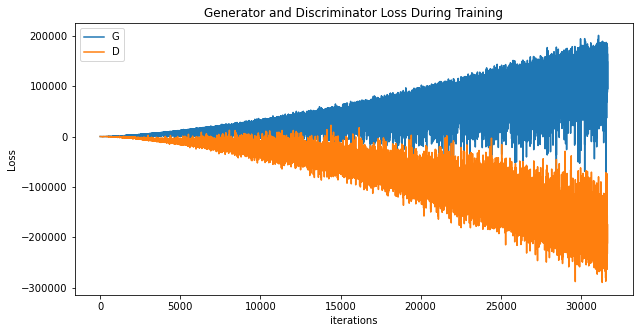

In [17]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Visualization of G’s progression**

Remember how we saved the generator’s output on the fixed_noise batch
after every epoch of training. Now, we can visualize the training
progression of G with an animation. Press the play button to start the
animation.




Animation size has reached 21486555 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


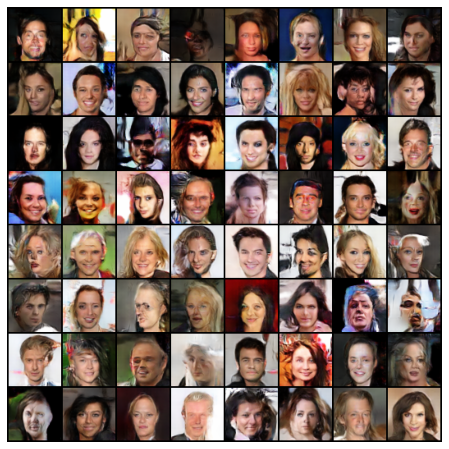

In [18]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Real Images vs. Fake Images**

Finally, lets take a look at some real images and fake images side by
side.




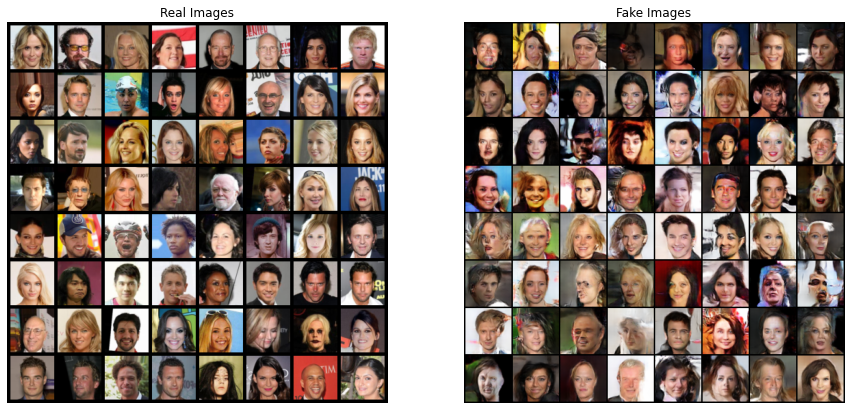

In [19]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## Calculate FID scores
- Calculate FID scores by the way given in practice.
- Binary candidate selector : Assume Decriminator is good, and then let our pick reasonable pictures only.

In [30]:
from fid_score import calculate_fid_given_paths  # The code is downloaded from github

real_dataloader = torch.utils.data.DataLoader(dataset, batch_size=1000,
                                         shuffle=True, num_workers=workers)

def save_image_list(dataset, real):
    if real:
        base_path = './img/real'
    else:
        base_path = './img/fake'
    
    dataset_path = []
    
    for i in range(len(dataset)):
        save_path =  f'{base_path}/image_{i}.png'
        dataset_path.append(save_path)
        vutils.save_image(dataset[i], save_path)
    
    return base_path

for i, (data, _) in enumerate(real_dataloader):
    real_dataset = data
    data.size()
    if i == 1:
        break

noise_cand = torch.randn(2, 1000, nz, 1, 1, device=device)
noise = torch.empty(1000, nz, 1, 1, device=device)

In [31]:
cand1 = netG(noise_cand[0]); label_cand1 = netD(cand1).view(-1);
cand2 = netG(noise_cand[1]); label_cand2 = netD(cand2).view(-1);

for i in range(1000):
    noise[i] = noise_cand[0,i]
    if label_cand1[i] > label_cand2[i]:
        noise[i] = noise_cand[1,i]

del(noise_cand)

fake_dataset = netG(noise);

In [22]:
!mkdir img
!mkdir img/real
!mkdir img/fake

mkdir: cannot create directory ‘img’: File exists
mkdir: cannot create directory ‘img/real’: File exists
mkdir: cannot create directory ‘img/fake’: File exists


In [32]:
real_image_path_list = save_image_list(real_dataset, True)
fake_image_path_list = save_image_list(fake_dataset, False)

In [33]:
# calculate_fid_given_paths(paths, batch_size, cuda, dims)
fid_value = calculate_fid_given_paths([real_image_path_list, fake_image_path_list],
                                                          50, 
                                                          True,
                                                          2048)

print (f'FID score: {fid_value}')

100%|██████████| 20/20 [00:01<00:00, 11.88it/s]


FID score: 33.588010494153366
